# ConditionalDCGAN

## Importing Libraries

In [1]:
!pip install datasets torchsummary wget -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 24.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.0/172.0 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 49.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.5/239.5 kB 22.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.3/124.3 kB 361.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.6/301.6 kB 27.5 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import Dataset,DataLoader,Subset
import torchvision.utils as vutils
import torchvision
from torchvision import models
from torchvision.datasets import ImageFolder

from tqdm import tqdm
from typing import Literal
import os

## Config

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [18]:
class TrainingConfig():
  img_size = 32
  input_channels = 3
  num_classes = None
  latent_vector_size = 100
  gen_feature_size = 64
  dis_feature_size = 64
  batch_size = 64
  beta1 = 0.5
  learning_rate = 2e-4
  # gradient_accumulation_steps = 1
  model_checkpoint_epochs = 5
  save_image_epochs = 1
  # lr_warmup_steps = 500
  # max_grad_norm = 0.3
  device = 'cuda' if torch.cuda.is_available() else 'cpu'
  logging_steps = 500
  real_label = 0.0
  fake_label = 1.0

  output_dir = '/content/drive/MyDrive/GANs/cDCGAN' if os.path.isdir('/content/drive') else '/GANs/cDCGAN'
  seed = 69

  if not os.path.exists(output_dir):
    os.makedirs(output_dir)
  os.chdir(output_dir)
  print('Current Dierectory : ',os.getcwd())

  checkpoints_dir = os.path.join(output_dir,'checkpoints')
  if not os.path.exists(checkpoints_dir):
      os.makedirs(checkpoints_dir)

  samples_dir = os.path.join(output_dir,'samples')
  if not os.path.exists(samples_dir):
      os.makedirs(samples_dir)

config = TrainingConfig()

Current Dierectory :  /content/drive/MyDrive/GANs/cDCGAN


## CIFAR10 32x32

In [19]:
image_transforms = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

dataset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                       download=True, transform=image_transforms)

print(dataset.classes)

Files already downloaded and verified
['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']


In [20]:
# # Define the classes to keep
classes_to_keep = [0,1,7,8]

# Filter the dataset to keep only the specified classes
filtered_indices = [i for i, target in enumerate(dataset.targets) if target in classes_to_keep]

# Create a Subset of the original dataset
filtered_dataset = torch.utils.data.Subset(dataset, filtered_indices)

# Create the DataLoader for the filtered dataset
dataloader = torch.utils.data.DataLoader(filtered_dataset, batch_size=64, shuffle=True, num_workers=2)

config.num_classes = len(classes_to_keep)

## Faces Dataset

In [ ]:
from google.colab import userdata
import os

os.environ["KAGGLE_KEY"] = userdata.get('KAGGLE_KEY')
os.environ["KAGGLE_USERNAME"] = userdata.get('KAGGLE_USERNAME')

In [ ]:
dataset_dir = os.path.join(os.getcwd(),'faces')
if not os.path.exists(dataset_dir):
  !kaggle datasets download -d maciejgronczynski/biggest-genderface-recognition-dataset
  !unzip -qq 'biggest-genderface-recognition-dataset'

In [ ]:
image_transforms = transforms.Compose([
    transforms.Resize((config.img_size,config.img_size)),
    transforms.ToTensor()
])

# target_transforms = transforms.Compose([
#     transforms.Resize((config.img_size,config.img_size)),
#     transforms.ToTensor()
# ])

In [ ]:
dataset = ImageFolder(root = dataset_dir,transform=image_transforms)

In [ ]:
from collections import Counter

print(dict(Counter(dataset.targets)))

In [ ]:
# prompt: get 5000 random values between and 0 and 17678 (not including 17678) and other 5000 values between 17678 to 27167 ( not including 27167) both in a same sequence

import random
random_values_1 = random.sample(range(0, 17678), 5000)
random_values_2 = random.sample(range(17678, 27167), 5000)
indices = random_values_1 + random_values_2

In [ ]:
dataset = Subset(dataset,indices)

In [ ]:
dataloader = DataLoader(dataset,batch_size = config.batch_size,shuffle = True)

## Visualization

In [7]:
def find_opt_grid(x):
    # Initialize variables to store the optimal pair and the minimum difference
    optimal_a, optimal_b = None, None
    min_diff = float('inf')

    # Iterate over possible factors
    for a in range(1, int(x**0.5) + 1):
        if x % a == 0:
            b = x // a
            diff = abs(b - a)
            if diff < min_diff:
                min_diff = diff
                optimal_a, optimal_b = a, b

    return optimal_a, optimal_b

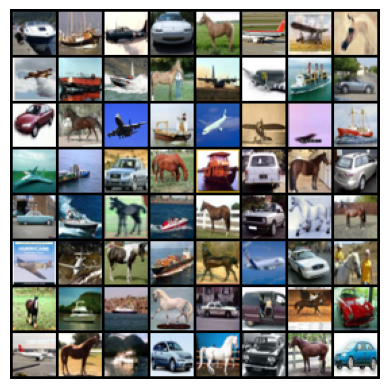

In [8]:
import matplotlib.pyplot as plt

a,b = find_opt_grid(config.batch_size)

for batch in dataloader:
  images,labels = batch
  fig,ax = plt.subplots()
  ax.imshow(vutils.make_grid(images, nrow = a,padding=2, normalize=True,scale_each=True).permute((1,2,0)))
  ax.axis('off')
  fig.show()
  break

## Model

In [9]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [10]:
class Generator(nn.Module):
    def __init__(self, config):
        super(Generator, self).__init__()
        self.latent_block = nn.Sequential(
            nn.Linear(config.latent_vector_size,1920),
            nn.ReLU(True),
        )

        self.condition_block = nn.Sequential(
            nn.Embedding(config.num_classes,128)
        )

        self.common_block = nn.Sequential(
            # state size. ``(config.gen_feature_size*8) x 2  x 2``
            nn.ConvTranspose2d(config.gen_feature_size*8, config.gen_feature_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size * 4),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size*4) x 4 x 4``
            nn.ConvTranspose2d(config.gen_feature_size * 4, config.gen_feature_size * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size * 2),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size*2) x 8 x 8``
            nn.ConvTranspose2d( config.gen_feature_size * 2, config.gen_feature_size, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.gen_feature_size),
            nn.ReLU(True),
            # state size. ``(config.gen_feature_size) x 16 x 16``
            nn.ConvTranspose2d( config.gen_feature_size, config.input_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 32 x 32``
        )

    def forward(self, input, label):
        out1 = self.latent_block(input)
        out1 = out1.view(-1,480,2,2)

        out2 = self.condition_block(label)
        out2 = out2.view(-1,32,2,2)

        out = torch.cat((out1,out2),dim = 1)
        return self.common_block(out)

In [11]:
input = torch.randn((config.batch_size,config.latent_vector_size),device = config.device)
label = torch.randint(0, config.num_classes, (config.batch_size,), device = config.device)

model = Generator(config).to(config.device)
print('Output size :', model(input,label).size())
print('Model.parameters :', count_parameters(model))

Output size : torch.Size([64, 3, 32, 32])
Model.parameters : 2950912


In [12]:
class Discriminator(nn.Module):
    def __init__(self, config):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc) x 32 x 32``
            nn.Conv2d(config.input_channels, config.dis_feature_size * 2, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(config.dis_feature_size * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*2) x 16 x 16``
            nn.Conv2d(config.dis_feature_size * 2, config.dis_feature_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.dis_feature_size * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*4) x 8 x 8``
            nn.Conv2d(config.dis_feature_size * 4, config.dis_feature_size * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(config.dis_feature_size * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(config.dis_feature_size*8) x 4 x 4``
        )
        self.aux_classifier = nn.Sequential(
            nn.Conv2d(config.dis_feature_size * 8, 10, 4, 1, 0, bias=False),
            nn.LogSoftmax(dim=1)
        )
        self.discriminator = nn.Sequential(
            nn.Conv2d(config.dis_feature_size * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
      out = self.main(input)
      aux_out = self.aux_classifier(out)
      dis_out = self.discriminator(out)
      return dis_out,aux_out

In [13]:
input = torch.randn((config.batch_size,config.input_channels,config.img_size,config.img_size),device = config.device)

model = Discriminator(config).to(config.device)
print('Output size :', model(input)[0].size(),model(input)[1].size())
print('Model.parameters :', count_parameters(model))

Output size : torch.Size([64, 1, 1, 1]) torch.Size([64, 10, 1, 1])
Model.parameters : 2719232


## Training Setup

In [14]:
from torch.optim import Adam
import numpy as np
import pandas as pd

class DCGAN():
  def __init__(self,config,dataloader):
    super(DCGAN,self).__init__()
    self.generator = Generator(config).to(config.device)
    self.discriminator = Discriminator(config).to(config.device)

   # custom weights initialization with normal distributed weights (0,0.02)
    self.weights_init(self.generator)
    self.weights_init(self.discriminator)

    self.dataloader = dataloader
    self.len_loader = len(dataloader)

    self.config = config

    self.dis_optimizer = Adam(self.discriminator.parameters(),lr = config.learning_rate,betas = (config.beta1,0.999))
    self.gen_optimizer = Adam(self.generator.parameters(),lr = config.learning_rate,betas = (config.beta1,0.999))

    self.dis_criterion = nn.BCELoss()
    self.aux_criterion = nn.NLLLoss()

    self.gen = torch.Generator(device = config.device)
    self.gen.manual_seed(config.seed)

    self.logs = pd.DataFrame({'batch':[],'epoch':[],'loss_D':[],'loss_G':[],'D_x':[],'D_G_z1':[],'D_G_z2':[],'D_acc':[]})
    self.logs_len = 0

  def weights_init(self,m):
      classname = m.__class__.__name__
      if classname.find('Conv') != -1:
          nn.init.normal_(m.weight.data, 0.0, 0.02)
      elif classname.find('BatchNorm') != -1:
          nn.init.normal_(m.weight.data, 1.0, 0.02)
          nn.init.constant_(m.bias.data, 0)

  def save_samples(self):
    with torch.no_grad():
      labels = torch.randint(0, self.config.num_classes, (self.config.batch_size,), generator = self.gen, device = self.config.device)

      latent = torch.randn((config.batch_size,config.latent_vector_size),device = config.device,generator = self.gen)

      out = self.generator(latent, labels)
      fig,ax = plt.subplots(1,1)
      nrow,ncol = find_opt_grid(self.config.batch_size)
      ax.imshow(vutils.make_grid(out.detach().cpu(), nrow = min(nrow,ncol),padding=2, normalize=True, scale_each = True).permute((1,2,0)))
      ax.axis('off');
      fig.tight_layout();
    return fig

  def FakeStep(self):
    self.dis_optimizer.zero_grad()

    labels = torch.randint(0, self.config.num_classes, (self.config.batch_size,), device = self.config.device)
    latent = torch.randn((self.config.batch_size,self.config.latent_vector_size),device = self.config.device)

    fake = self.generator(latent, labels)
    dis_out,aux_out = self.discriminator(fake.detach())
    dis_out = dis_out.view(-1)
    aux_out = aux_out.squeeze()
    dis_loss = self.dis_criterion(dis_out,torch.full(dis_out.shape, config.fake_label, device=config.device))
    aux_loss = self.aux_criterion(aux_out,labels)

    loss_D = dis_loss + aux_loss
    loss_D.backward()
    self.dis_optimizer.step()
    D_G_z1 = dis_out.mean().item()

    self.gen_optimizer.zero_grad()

    dis_out,aux_out = self.discriminator(fake)
    dis_out = dis_out.view(-1)
    aux_out = aux_out.squeeze()
    dis_loss = self.dis_criterion(dis_out,torch.full(dis_out.shape, config.real_label, device=config.device))
    aux_loss = self.aux_criterion(aux_out,labels)
    D_G_z2 = dis_out.mean().item()

    loss_G = dis_loss + aux_loss
    loss_G.backward()
    self.gen_optimizer.step()

    return loss_D.item(),loss_G.item(),D_G_z1,D_G_z2

  def RealStep(self,batch):
    self.dis_optimizer.zero_grad()

    images,labels = batch
    images = images.to(self.config.device)
    labels = labels.to(self.config.device)

    dis_out,aux_out = self.discriminator(images)
    dis_out = dis_out.view(-1)
    aux_out = aux_out.squeeze()
    dis_loss = self.dis_criterion(dis_out,torch.full(dis_out.shape, config.real_label, device=config.device))
    aux_loss = self.aux_criterion(aux_out,labels)

    loss = dis_loss + aux_loss
    loss.backward()
    self.dis_optimizer.step()

    D_x = dis_out.mean().item()
    real,preds = torch.argmax(labels,-1),torch.argmax(aux_out,-1)
    acc = torch.sum(real==preds)/self.config.batch_size

    return loss.item(),D_x, acc

  def Train(self,epochs):
    try:
      start_epoch = self.config.epochs_trained
    except AttributeError:
      start_epoch = 0
    end_epoch = start_epoch + epochs
    self.config.epochs_trained = start_epoch

    self.generator.train()
    self.discriminator.train()

    for epoch in range(start_epoch,end_epoch):

      for i,batch in enumerate(self.dataloader):
        loss_DR, D_x, D_r_acc = self.RealStep(batch)
        loss_DF,loss_G,D_G_z1,D_G_z2 = self.FakeStep()
        loss_D = loss_DF + loss_DR

        self.logs.loc[self.logs_len] = [i + self.len_loader*epoch,epoch,loss_D,loss_G,D_x, D_G_z1, D_G_z2,D_r_acc.item()]
        self.logs_len += 1

        if config.logging_steps is not None and (self.len_loader*epoch + i + 1)%config.logging_steps == 0:
          print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'% (epoch, end_epoch, i, self.len_loader,loss_D, loss_G, D_x, D_G_z1, D_G_z2))

      if (epoch + 1)%config.model_checkpoint_epochs == 0:
        torch.save(self.generator,os.path.join(self.config.checkpoints_dir,f'generator_{epoch}.pt'))

      if (epoch + 1)%config.save_image_epochs == 0:
        fig = self.save_samples();
        fig.savefig(os.path.join(self.config.samples_dir, f'sample_{epoch}.png'));
        plt.close(fig);

      self.config.epochs_trained += 1

## Training

In [21]:
trainer = DCGAN(config,dataloader)

In [22]:
config.logging_steps = 200

In [23]:
trainer.Train(epochs = 25)

[0/25][199/313]	Loss_D: 1.5627	Loss_G: 10.2500	D(x): 0.1092	D(G(z)): 0.5599 / 1.0000
[1/25][86/313]	Loss_D: 0.7791	Loss_G: 5.1979	D(x): 0.0493	D(G(z)): 0.9146 / 0.9926
[1/25][286/313]	Loss_D: 0.8364	Loss_G: 5.2292	D(x): 0.0526	D(G(z)): 0.9798 / 0.9935
[2/25][173/313]	Loss_D: 0.7337	Loss_G: 5.7871	D(x): 0.0724	D(G(z)): 0.9347 / 0.9940
[3/25][60/313]	Loss_D: 1.0364	Loss_G: 5.7460	D(x): 0.1588	D(G(z)): 0.8872 / 0.9930
[3/25][260/313]	Loss_D: 0.6430	Loss_G: 6.2427	D(x): 0.0534	D(G(z)): 0.9195 / 0.9963
[4/25][147/313]	Loss_D: 0.4112	Loss_G: 5.6574	D(x): 0.0622	D(G(z)): 0.9403 / 0.9947
[5/25][34/313]	Loss_D: 0.3524	Loss_G: 5.6345	D(x): 0.0374	D(G(z)): 0.8989 / 0.9946
[5/25][234/313]	Loss_D: 1.1412	Loss_G: 7.7935	D(x): 0.1884	D(G(z)): 0.7495 / 0.9994
[6/25][121/313]	Loss_D: 0.2437	Loss_G: 6.2040	D(x): 0.0180	D(G(z)): 0.9758 / 0.9946
[7/25][8/313]	Loss_D: 0.6105	Loss_G: 6.6790	D(x): 0.1398	D(G(z)): 0.9245 / 0.9971
[7/25][208/313]	Loss_D: 0.6373	Loss_G: 6.4188	D(x): 0.0711	D(G(z)): 0.8688 / 0.9

In [24]:
trainer.Train(epochs = 25)

[25/50][174/313]	Loss_D: 0.2534	Loss_G: 6.5607	D(x): 0.0441	D(G(z)): 0.9927 / 0.9941
[26/50][61/313]	Loss_D: 0.2446	Loss_G: 8.8600	D(x): 0.0382	D(G(z)): 0.9460 / 0.9937
[26/50][261/313]	Loss_D: 0.0599	Loss_G: 6.1642	D(x): 0.0151	D(G(z)): 0.9825 / 0.9936
[27/50][148/313]	Loss_D: 0.2397	Loss_G: 7.1343	D(x): 0.0793	D(G(z)): 0.9266 / 0.9962
[28/50][35/313]	Loss_D: 0.1718	Loss_G: 6.4529	D(x): 0.0206	D(G(z)): 0.9221 / 0.9964
[28/50][235/313]	Loss_D: 0.1473	Loss_G: 6.4112	D(x): 0.0449	D(G(z)): 0.9796 / 0.9918
[29/50][122/313]	Loss_D: 0.2844	Loss_G: 7.0551	D(x): 0.0663	D(G(z)): 0.9014 / 0.9956
[30/50][9/313]	Loss_D: 0.5461	Loss_G: 11.4036	D(x): 0.0950	D(G(z)): 0.7549 / 0.9994
[30/50][209/313]	Loss_D: 0.3645	Loss_G: 8.3889	D(x): 0.0397	D(G(z)): 0.8734 / 0.9994
[31/50][96/313]	Loss_D: 0.1814	Loss_G: 20.9598	D(x): 0.0082	D(G(z)): 0.9771 / 0.9950
[31/50][296/313]	Loss_D: 0.4884	Loss_G: 6.3141	D(x): 0.1589	D(G(z)): 0.9322 / 0.9869
[32/50][183/313]	Loss_D: 0.6627	Loss_G: 11.2915	D(x): 0.1260	D(G(z))

In [25]:
trainer.Train(epochs = 30)

[50/80][149/313]	Loss_D: 0.2105	Loss_G: 18.4681	D(x): 0.0485	D(G(z)): 0.9383 / 0.9989
[51/80][36/313]	Loss_D: 0.0509	Loss_G: 40.0472	D(x): 0.0065	D(G(z)): 0.9991 / 0.9997
[51/80][236/313]	Loss_D: 0.2193	Loss_G: 6.3329	D(x): 0.0191	D(G(z)): 0.9604 / 0.9945
[52/80][123/313]	Loss_D: 0.8987	Loss_G: 24.6294	D(x): 0.3424	D(G(z)): 0.9977 / 0.9915
[53/80][10/313]	Loss_D: 0.1962	Loss_G: 6.8463	D(x): 0.0427	D(G(z)): 0.9197 / 0.9973
[53/80][210/313]	Loss_D: 0.1180	Loss_G: 5.8029	D(x): 0.0179	D(G(z)): 0.9847 / 0.9956
[54/80][97/313]	Loss_D: 0.0318	Loss_G: 21.1464	D(x): 0.0084	D(G(z)): 0.9831 / 0.9943
[54/80][297/313]	Loss_D: 0.0309	Loss_G: 19.2076	D(x): 0.0123	D(G(z)): 0.9924 / 0.9969
[55/80][184/313]	Loss_D: 0.1560	Loss_G: 14.6171	D(x): 0.0382	D(G(z)): 0.9595 / 0.9939
[56/80][71/313]	Loss_D: 0.1751	Loss_G: 5.9580	D(x): 0.0256	D(G(z)): 0.9693 / 0.9954
[56/80][271/313]	Loss_D: 0.5755	Loss_G: 10.7456	D(x): 0.0381	D(G(z)): 0.7516 / 0.9998
[57/80][158/313]	Loss_D: 0.0764	Loss_G: 16.4343	D(x): 0.0314	D

## Results

In [26]:
import plotly.graph_objects as go

def plot_results(trainer,plot_type: Literal['per_batch','per_epoch']):
  if plot_type not in ['per_batch','per_epoch']:
      raise ValueError(f"Invalid plot_type: {plot_type}")

  fig = go.Figure()
  if plot_type == 'per_batch':
    fig.add_trace(go.Scatter(y = trainer.logs['loss_D'], name='Loss_D'))
    fig.add_trace(go.Scatter(y = trainer.logs['loss_G'], name='Loss_G'))

  else:
    fig.add_trace(go.Scatter(y =trainer.logs.groupby('epoch')['loss_D'].mean(), name='Loss_D'))
    fig.add_trace(go.Scatter(y = trainer.logs.groupby('epoch')['loss_G'].mean(), name='Loss_G'))

  fig.update_layout(
      title_text="Loss " + plot_type,
      # width = size[1],
      # height = size[0]
  )

  return fig

In [27]:
plot_results(trainer,plot_type= 'per_batch')

In [35]:
plot_results(trainer,plot_type= 'per_epoch')

## Samples Visulaization

In [30]:
import re

file_list = os.listdir(config.samples_dir)

def extract_number(filename):
    match = re.search(r'\d+', filename)
    return int(match.group()) if match else -1

sorted_paths = sorted(file_list, key=extract_number)

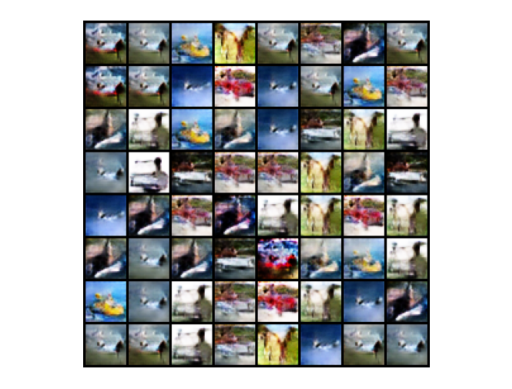

In [32]:
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib.animation import ArtistAnimation,FFMpegWriter

# Set up the figure and axis
fig, ax = plt.subplots()
plt.axis("off")
ims = []
for filename in sorted_paths:
    im = plt.imread(os.path.join(config.samples_dir, filename))
    ims.append([plt.imshow(im, animated=True)])

ani = ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [34]:
ani.save(os.getcwd() + '/' + 'anim.mp4')

## Inference

In [72]:
plt.rcParams.update({'font.size': 4})

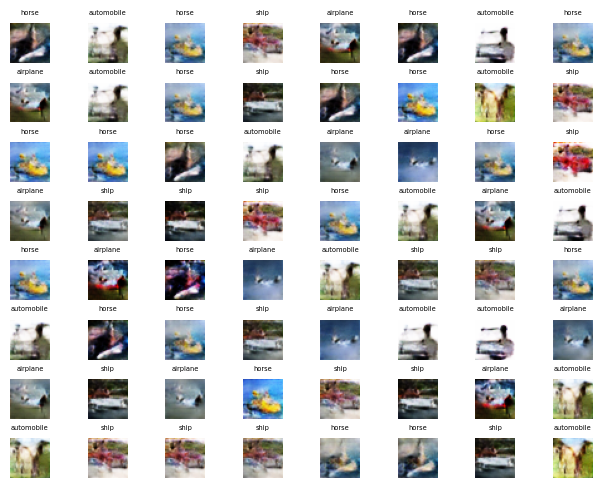

In [74]:
with torch.no_grad():
      labels = torch.randint(0, config.num_classes, (config.batch_size,), device = config.device)
      latent = torch.randn((config.batch_size,config.latent_vector_size),device = config.device)

      a,b = find_opt_grid(config.batch_size)

      out = trainer.generator(latent, labels)
      fig,ax = plt.subplots(b,a)
      for i in range(b):
        for j in range(a):
          ax[i][j].imshow((out[b*i+j].detach().permute((1,2,0)).cpu().numpy()+1)/2,)
          ax[i][j].set_title(np.array(dataset.classes)[classes_to_keep][labels[b*i+j]])
          ax[i][j].axis('off');
      fig.tight_layout();
      fig.show();